# Refine tangram annotations using clustering for breast_s1

In [1]:
slide_id = "breast_s1"

In [2]:
import pandas as pd
import scanpy as sc
import spatialdata as sd
import decoupler as dc
from collections import Counter
from bioservices.kegg import KEGG

/Users/felicie-giraud-sauveur/miniforge3/envs/cluster/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


## 1. Load the data

In [3]:
sdata = sd.read_zarr(f"/Volumes/DD_FGS/MICS/data_HE2CellType/CT_DS/sdata_tangram_annots/sdata_tangram_{slide_id}.zarr")
sdata

/var/folders/ff/llzyqd_s78v1k8vywvjxp5_r0000gn/T/ipykernel_58331/4156079343.py:1: DeprecationWarning: Table group found in zarr store at location /Volumes/One Touch/MICS/data_HE2CellType/CT_DS/sdata_tangram_annots/sdata_tangram_breast_s1.zarr. Please update the zarr storeto use tables instead.
  sdata = sd.read_zarr(f"/Volumes/One Touch/MICS/data_HE2CellType/CT_DS/sdata_tangram_annots/sdata_tangram_{slide_id}.zarr")


SpatialData object with:
├── Images
│     └── 'he': MultiscaleSpatialImage[cyx] (3, 107121, 51351), (3, 53560, 25675)
├── Points
│     └── 'st': DataFrame with shape: (126857390, 8) (3D points)
├── Shapes
│     └── 'nucleus_boundaries': GeoDataFrame shape: (892966, 1) (2D shapes)
└── Tables
      └── 'table': AnnData (892966, 541)
with coordinate systems:
▸ '_st_intrinsic', with elements:
        st (Points)
▸ 'global', with elements:
        he (Images), st (Points), nucleus_boundaries (Shapes)

In [4]:
adata_ini = sdata.table.copy()
adata_ini

/var/folders/ff/llzyqd_s78v1k8vywvjxp5_r0000gn/T/ipykernel_58331/823217089.py:1: DeprecationWarning: Table accessor will be deprecated with SpatialData version 0.1, use sdata.tables instead.
  adata_ini = sdata.table.copy()


AnnData object with n_obs × n_vars = 892966 × 541
    obs: 'region', 'slide', 'cell_id', 'area', 'ct_tangram'
    uns: 'sopa_attrs', 'spatialdata_attrs'
    obsm: 'spatial', 'tangram_pred'

In [5]:
adata_ini.obs

,region,slide,cell_id,area,ct_tangram
aaaaaaaa-1,nucleus_boundaries,morpho,aaaaaaaa-1,29.508303,Monocyte
aaaaaaab-1,nucleus_boundaries,morpho,aaaaaaab-1,28.244812,CREB+MT1A+ vascular smooth muscle cell
aaaaaaac-1,nucleus_boundaries,morpho,aaaaaaac-1,7.202566,M1 macrophage
aaaaaaad-1,nucleus_boundaries,morpho,aaaaaaad-1,50.282740,SCGB3A1 mammary luminal progenitor
aaaaaaae-1,nucleus_boundaries,morpho,aaaaaaae-1,56.647940,CCL19/21 pericyte
...,...,...,...,...,...
aaankacb-1,nucleus_boundaries,morpho,aaankacb-1,16.167266,Dendritic cell
aaankacc-1,nucleus_boundaries,morpho,aaankacc-1,35.423439,Dendritic cell
aaankacd-1,nucleus_boundaries,morpho,aaankacd-1,127.343219,KRT6B mammary basal cell
aaankace-1,nucleus_boundaries,morpho,aaankace-1,10.049029,Dendritic cell


In [6]:
adata_ini.var

""
ABCC11
ACTA2
ACTG2
ADAM9
ADGRE5
...
VWF
WARS
ZEB1
ZEB2


## 2. Preprocessing

In [7]:
# Add transcripts counts
adata_ini.obs["transcript_counts"] = adata_ini.X.sum(axis=1)
adata_ini.obs

,region,slide,cell_id,area,ct_tangram,transcript_counts
aaaaaaaa-1,nucleus_boundaries,morpho,aaaaaaaa-1,29.508303,Monocyte,37
aaaaaaab-1,nucleus_boundaries,morpho,aaaaaaab-1,28.244812,CREB+MT1A+ vascular smooth muscle cell,22
aaaaaaac-1,nucleus_boundaries,morpho,aaaaaaac-1,7.202566,M1 macrophage,6
aaaaaaad-1,nucleus_boundaries,morpho,aaaaaaad-1,50.282740,SCGB3A1 mammary luminal progenitor,47
aaaaaaae-1,nucleus_boundaries,morpho,aaaaaaae-1,56.647940,CCL19/21 pericyte,43
...,...,...,...,...,...,...
aaankacb-1,nucleus_boundaries,morpho,aaankacb-1,16.167266,Dendritic cell,7
aaankacc-1,nucleus_boundaries,morpho,aaankacc-1,35.423439,Dendritic cell,1
aaankacd-1,nucleus_boundaries,morpho,aaankacd-1,127.343219,KRT6B mammary basal cell,61
aaankace-1,nucleus_boundaries,morpho,aaankace-1,10.049029,Dendritic cell,5


<Axes: >

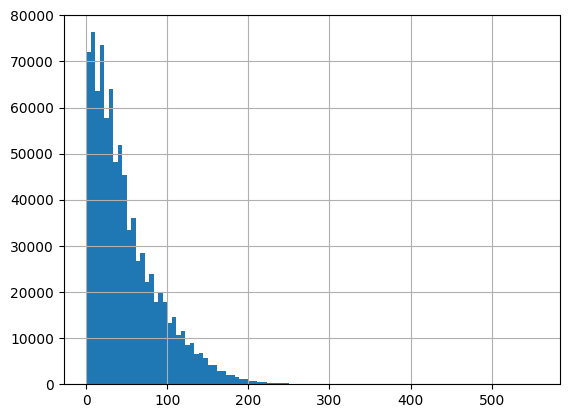

In [8]:
adata_ini.obs['transcript_counts'].hist(bins=100)

<Axes: >

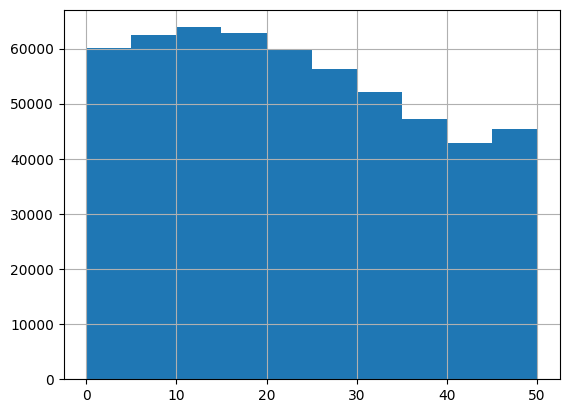

In [9]:
# in range 0-50
adata_ini.obs['transcript_counts'].hist(range=(0,50))

In [10]:
print(f"Number of cells with less than 20 transcripts: {(adata_ini.obs['transcript_counts']<20).sum()}")
print(f"Percentage of cells with less than 20 transcripts: {round(((adata_ini.obs['transcript_counts']<20).sum())/len(adata_ini.obs)*100, 2)}%")
print('-----')
print(f"Number of cells with less than 15 transcripts: {(adata_ini.obs['transcript_counts']<15).sum()}")
print(f"Percentage of cells with less than 15 transcripts: {round(((adata_ini.obs['transcript_counts']<15).sum())/len(adata_ini.obs)*100, 2)}%")
print('-----')
print(f"Number of cells with less than 10 transcripts: {(adata_ini.obs['transcript_counts']<10).sum()}")
print(f"Percentage of cells with less than 10 transcripts: {round(((adata_ini.obs['transcript_counts']<10).sum())/len(adata_ini.obs)*100, 2)}%")
print('-----')
print(f"Number total of cells: {len(adata_ini.obs)}")

Number of cells with less than 20 transcripts: 249271
Percentage of cells with less than 20 transcripts: 27.91%
-----
Number of cells with less than 15 transcripts: 186515
Percentage of cells with less than 15 transcripts: 20.89%
-----
Number of cells with less than 10 transcripts: 122665
Percentage of cells with less than 10 transcripts: 13.74%
-----
Number total of cells: 892966


In [11]:
adata =  adata_ini[adata_ini.obs['transcript_counts']>10].copy()
print(len(adata.obs))

757374


In [12]:
# Save the raw data
adata.layers['count'] = adata.X.copy()

In [13]:
# Normalize
sc.pp.normalize_total(adata, target_sum=1e4)
sc.pp.log1p(adata)
adata.layers['log_norm'] = adata.X.copy()

In [14]:
# Scale each gene to unit variance. Clip values exceeding standard deviation 10.
sc.pp.scale(adata, max_value=10)

## 3. Principal component analysis

In [15]:
# Reduce the dimensionality of the data by running principal component analysis (PCA), which reveals the main axes of variation and denoises the data.
sc.tl.pca(adata, svd_solver="arpack", use_highly_variable=False)

/Users/felicie-giraud-sauveur/miniforge3/envs/cluster/lib/python3.10/site-packages/scanpy/preprocessing/_pca.py:374: FutureWarning: Argument `use_highly_variable` is deprecated, consider using the mask argument. Use_highly_variable=True can be called through mask_var="highly_variable". Use_highly_variable=False can be called through mask_var=None
  warn(msg, FutureWarning)


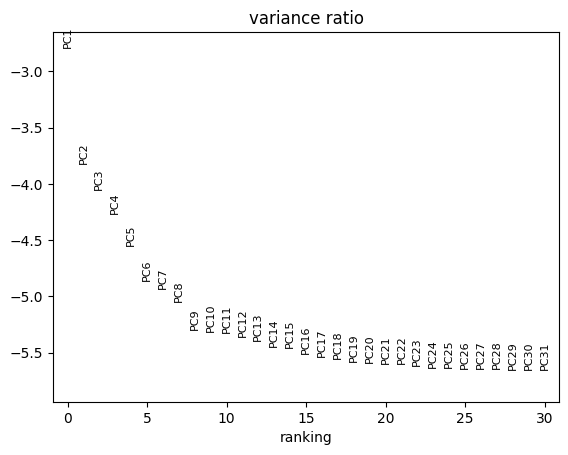

In [16]:
# Contribution of single PCs to the total variance in the data
# This gives us information about how many PCs we should consider in order to compute the neighborhood relations of cells, e.g. used in the clustering function  `sc.tl.louvain()` or tSNE `sc.tl.tsne()`
sc.pl.pca_variance_ratio(adata, log=True)

In [17]:
adata

AnnData object with n_obs × n_vars = 757374 × 541
    obs: 'region', 'slide', 'cell_id', 'area', 'ct_tangram', 'transcript_counts'
    var: 'mean', 'std'
    uns: 'sopa_attrs', 'spatialdata_attrs', 'log1p', 'pca'
    obsm: 'spatial', 'tangram_pred', 'X_pca'
    varm: 'PCs'
    layers: 'count', 'log_norm'

In [18]:
# Restore X to be log norm counts
# /!\ ALL the following analysis will use the 'log_norm' layer as input /!\
dc.swap_layer(adata, 'log_norm', X_layer_key=None, inplace=True)

## 4. The neighborhood graph + clustering

In [19]:
# Neighborhood graph of cells using the PCA representation of the data matrix
sc.pp.neighbors(adata, n_neighbors=10, n_pcs=16, use_rep="X_pca", key_added='pca_n10_pcs16')
# Embedding the neighborhood graph using UMAP
sc.tl.umap(adata, neighbors_key='pca_n10_pcs16')
# Leiden clustering directly clusters the neighborhood graph of cells
sc.tl.leiden(adata, resolution=0.2, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs16_leiden_res0.2', neighbors_key='pca_n10_pcs16')
sc.tl.leiden(adata, resolution=0.4, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs16_leiden_res0.4', neighbors_key='pca_n10_pcs16')
sc.tl.leiden(adata, resolution=0.6, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs16_leiden_res0.6', neighbors_key='pca_n10_pcs16')

/Users/felicie-giraud-sauveur/miniforge3/envs/cluster/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
/var/folders/ff/llzyqd_s78v1k8vywvjxp5_r0000gn/T/ipykernel_58331/2486232371.py:6: FutureWarning: In the future, the default backend for leiden will be igraph instead of leidenalg.

 To achieve the future defaults please pass: flavor="igraph" and n_iterations=2.  directed must also be False to work with igraph's implementation.
  sc.tl.leiden(adata, resolution=0.2, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs16_leiden_res0.2', neighbors_key='pca_n10_pcs16')


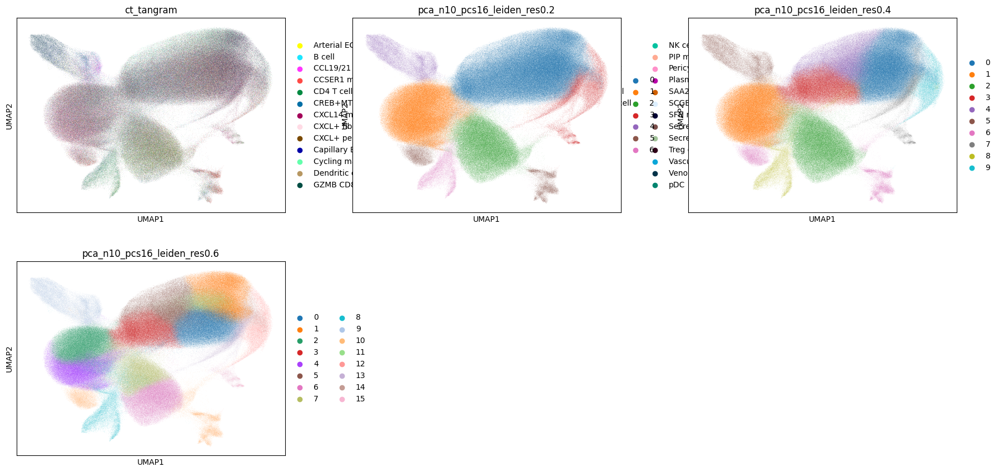

In [20]:
# Plot the clusters
sc.pl.umap(adata, neighbors_key='pca_n10_pcs16',
           color=['ct_tangram', 'pca_n10_pcs16_leiden_res0.2', 'pca_n10_pcs16_leiden_res0.4', 'pca_n10_pcs16_leiden_res0.6'],
           ncols=3)

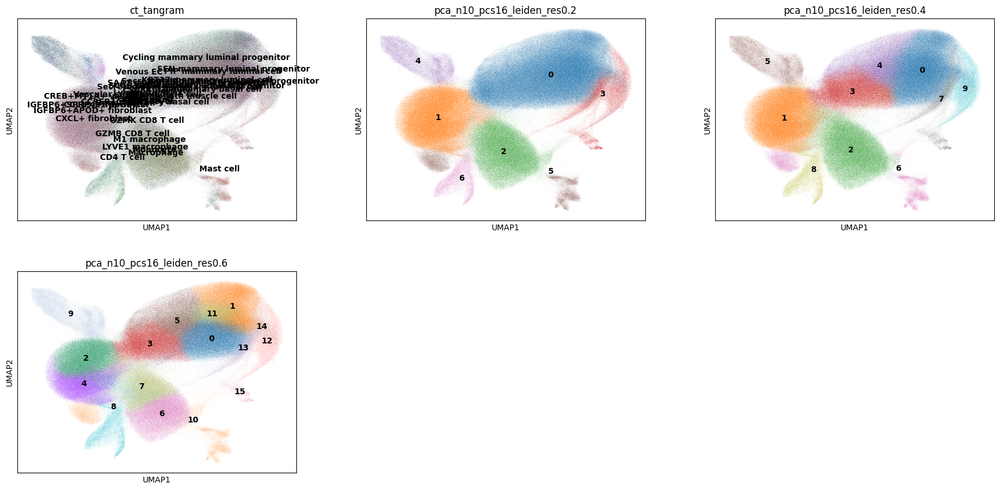

In [21]:
# Plot the clusters
sc.pl.umap(adata, neighbors_key='pca_n10_pcs16',
           color=['ct_tangram', 'pca_n10_pcs16_leiden_res0.2', 'pca_n10_pcs16_leiden_res0.4', 'pca_n10_pcs16_leiden_res0.6'],
           ncols=3, legend_loc='on data')

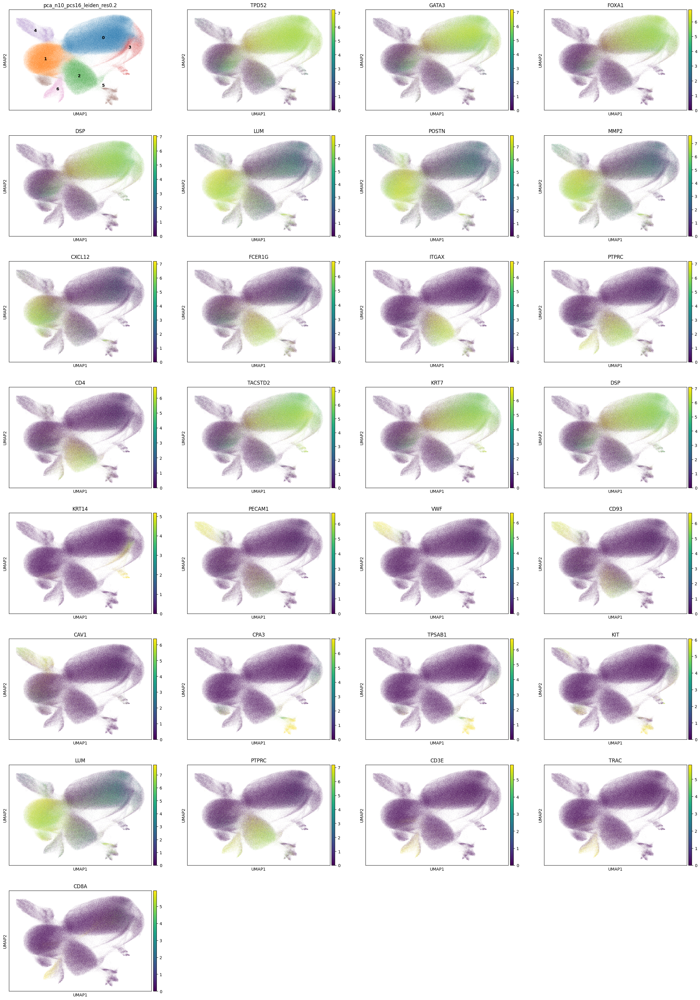

In [22]:
clustering_label = 'pca_n10_pcs16_leiden_res0.2'

# Wilcoxon rank-sum (Mann-Whitney-U) test
sc.tl.rank_genes_groups(adata, clustering_label, method="wilcoxon", corr_method="benjamini-hochberg", key_added="rank_genes_"+clustering_label)

# The 4 top ranked genes per cluster
df = pd.DataFrame(adata.uns["rank_genes_"+clustering_label]["names"]).iloc[:4, :]
list_genes = pd.concat([df[col] for col in df], ignore_index=True).tolist()
sc.pl.umap(adata, color=[clustering_label]+list_genes, vmax="p99", vmin=0, ncols=4, legend_loc='on data')

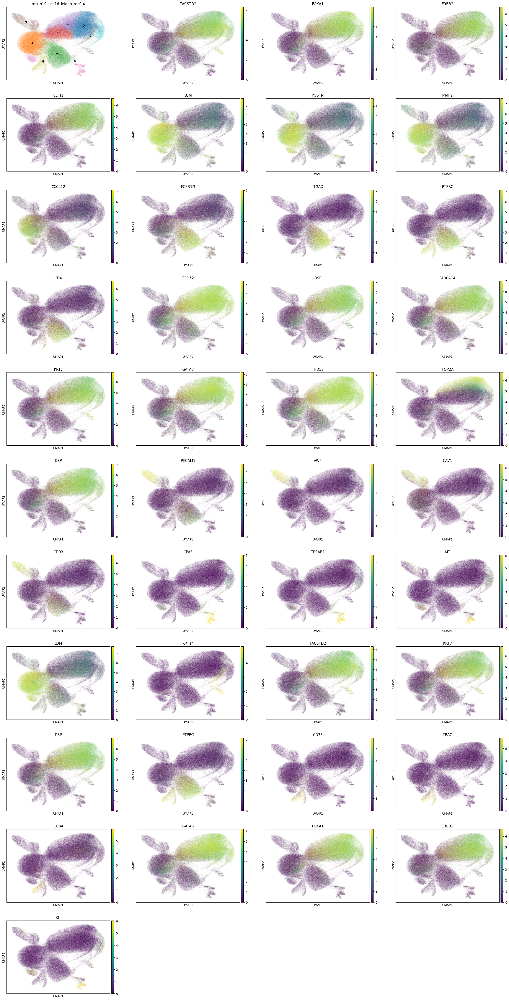

In [23]:
clustering_label = 'pca_n10_pcs16_leiden_res0.4'

# Wilcoxon rank-sum (Mann-Whitney-U) test
sc.tl.rank_genes_groups(adata, clustering_label, method="wilcoxon", corr_method="benjamini-hochberg", key_added="rank_genes_"+clustering_label)

# The 4 top ranked genes per cluster
df = pd.DataFrame(adata.uns["rank_genes_"+clustering_label]["names"]).iloc[:4, :]
list_genes = pd.concat([df[col] for col in df], ignore_index=True).tolist()
sc.pl.umap(adata, color=[clustering_label]+list_genes, vmax="p99", vmin=0, ncols=4, legend_loc='on data')

In [24]:
# Number of clusters
adata.obs['pca_n10_pcs16_leiden_res0.2'].unique()

['1', '5', '2', '0', '3', '4', '6']
Categories (7, object): ['0', '1', '2', '3', '4', '5', '6']

In [59]:
# Refine resolution
adata.obs['refine_res'] = 'att'

adata.obs.loc[adata.obs['pca_n10_pcs16_leiden_res0.2'].isin(['0', '3']), 'refine_res'] = '0'
adata.obs.loc[adata.obs['pca_n10_pcs16_leiden_res0.2'].isin(['1']), 'refine_res'] = '1'
adata.obs.loc[adata.obs['pca_n10_pcs16_leiden_res0.2'].isin(['2']), 'refine_res'] = '2'
adata.obs.loc[adata.obs['pca_n10_pcs16_leiden_res0.2'].isin(['4']), 'refine_res'] = '3'
adata.obs.loc[adata.obs['pca_n10_pcs16_leiden_res0.2'].isin(['5']), 'refine_res'] = '4'
adata.obs.loc[adata.obs['pca_n10_pcs16_leiden_res0.2'].isin(['6']), 'refine_res'] = '5'

adata.obs.loc[adata.obs['pca_n10_pcs16_leiden_res0.4'].isin(['7']), 'refine_res'] = '6'

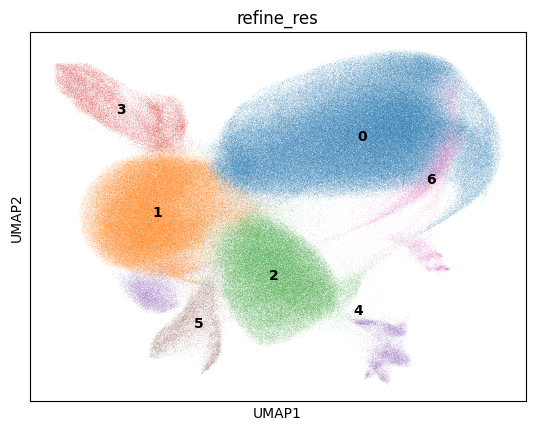

In [60]:
# Plot the clusters
sc.pl.umap(adata, neighbors_key='pca_n10_pcs16', color=['refine_res'], legend_loc='on data')

## 5. Name clusters

**To go from specific gene marker to cell type: http://xteam.xbio.top/CellMarker/search.jsp?cellMarkerSpeciesType=Human&cellMarker=CD5L**

In [61]:
clustering_label = 'refine_res'

In [62]:
def get_top_tangram_labels_for_clustering(adata, clustering_key, top_n=3):

    grouped = adata.obs.groupby(clustering_key)
    results = []
    
    for cluster, group in grouped:
        
        label_counts = Counter(group['ct_tangram'])
        total_cells = len(group)
        label_percentages = [(label, round(count / total_cells * 100)) for label, count in label_counts.items()]
        top_labels = sorted(label_percentages, key=lambda x: x[1], reverse=True)[:top_n]
        
        for label, percentage in top_labels:
            results.append({
                'Cluster': cluster,
                'Label': label,
                'Percentage': percentage
            })
    
    cluster_df = pd.DataFrame(results)
    
    return cluster_df

top_tangram = get_top_tangram_labels_for_clustering(adata, clustering_label, top_n=7)

/var/folders/ff/llzyqd_s78v1k8vywvjxp5_r0000gn/T/ipykernel_58331/3112203278.py:3: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped = adata.obs.groupby(clustering_key)


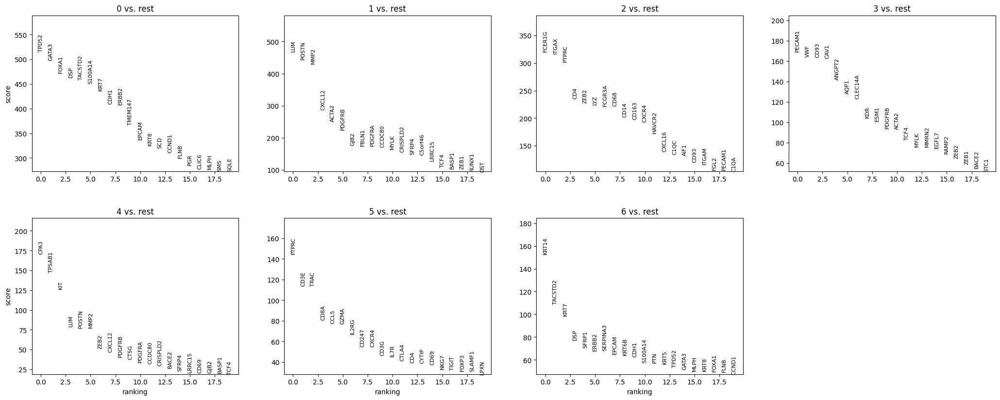

In [63]:
# Wilcoxon rank-sum (Mann-Whitney-U) test. 
# You might also consider much more powerful differential testing packages like MAST, limma, DESeq2 and, for python, the recent diffxpy.
sc.tl.rank_genes_groups(adata, clustering_label, method="wilcoxon", corr_method="benjamini-hochberg", key_added="rank_genes_"+clustering_label)
sc.pl.rank_genes_groups(adata, n_genes=20, sharey=False, key="rank_genes_"+clustering_label)

In [64]:
# The top ranked genes per cluster
top_ranked_genes = pd.DataFrame(adata.uns["rank_genes_"+clustering_label]["names"]).iloc[:5, :]
list_genes = pd.concat([top_ranked_genes[col] for col in top_ranked_genes], ignore_index=True).tolist()

In [65]:
adata.obs['label1'] = 'att'
adata.obs['label2'] = 'att'
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

### 5.1. Cluster 0

In [66]:
cluster_id = '0'

In [67]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
0,0,SFN mammary luminal progenitor,11
1,0,CXCL14 mammary basal cell,8
2,0,KRT6B mammary basal cell,7
3,0,Secretoglobin mammary luminal progenitor,7
4,0,Cycling mammary luminal progenitor,7
5,0,Venous EC,5
6,0,PIP mammary luminal cell,5


In [68]:
top_ranked_genes[cluster_id]

0      TPD52
1      GATA3
2      FOXA1
3        DSP
4    TACSTD2
Name: 0, dtype: object

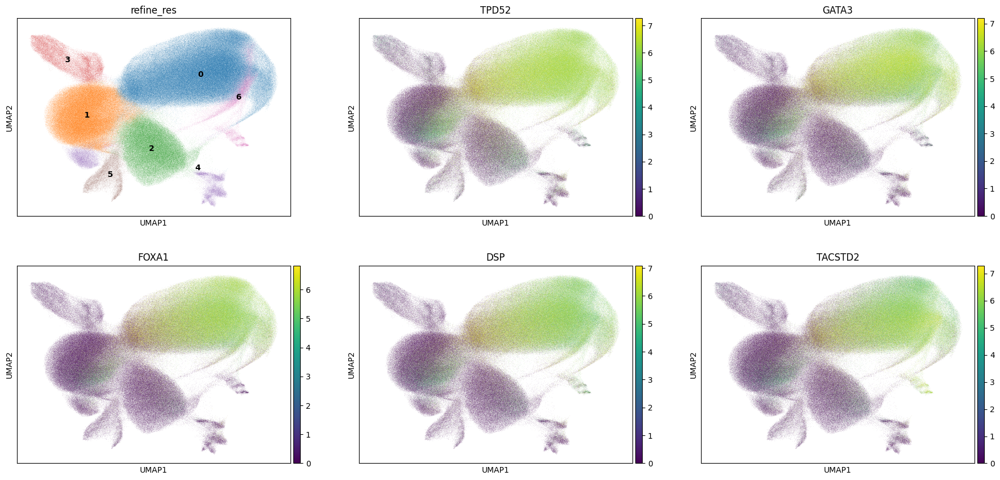

In [69]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*5:int(cluster_id)*5+5], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [70]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 0: 370502
Percentage of cells in cluster 0: 48.9


In [71]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'Epithelial'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'Mammary_luminal_cell'

### 5.2. Cluster 1

In [72]:
cluster_id = '1'

In [73]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
7,1,CXCL+ fibroblast,11
8,1,IGFBP6+APOD+ fibroblast,10
9,1,CXCL14 mammary basal cell,7
10,1,IGFBP6+SFRP4+ fibroblast,7
11,1,CCSER1 mammary basal cell,6
12,1,CREB+MT1A+ vascular smooth muscle cell,5
13,1,Dendritic cell,5


In [74]:
top_ranked_genes[cluster_id]

0       LUM
1     POSTN
2      MMP2
3    CXCL12
4     ACTA2
Name: 1, dtype: object

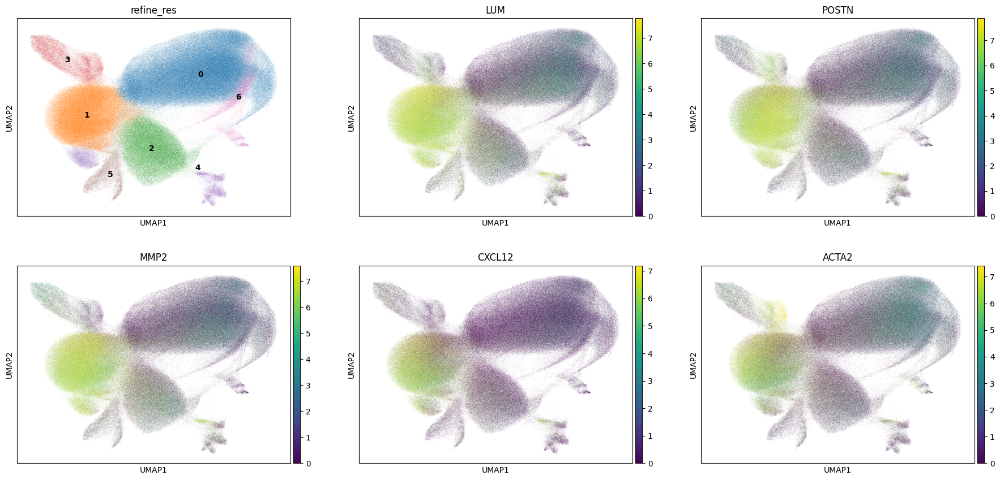

In [75]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*5:int(cluster_id)*5+5], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [76]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 1: 181750
Percentage of cells in cluster 1: 24.0


In [77]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'Fibroblast'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'CAF'

### 5.3. Cluster 2

In [78]:
cluster_id = '2'

In [79]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
14,2,Monocyte,21
15,2,Macrophage,18
16,2,LYVE1 macrophage,8
17,2,M1 macrophage,6
18,2,Venous EC,4
19,2,CREB+MT1A+ vascular smooth muscle cell,4
20,2,CD4 T cell,4


In [80]:
top_ranked_genes[cluster_id]

0    FCER1G
1     ITGAX
2     PTPRC
3       CD4
4      ZEB2
Name: 2, dtype: object

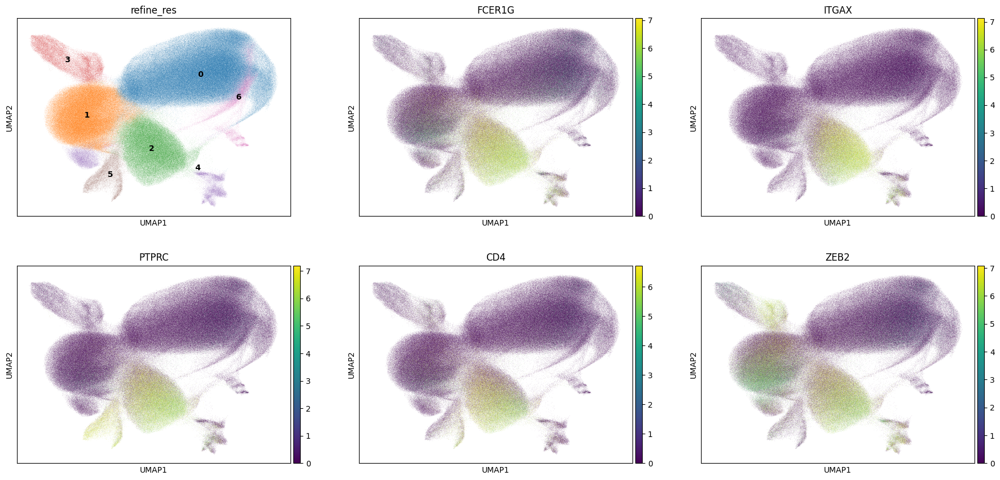

In [81]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*5:int(cluster_id)*5+5], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [82]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 2: 110393
Percentage of cells in cluster 2: 14.6


In [83]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'Monocyte/Macrophage'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'Monocyte/Macrophage'

### 5.4. Cluster 3

In [84]:
cluster_id = '3'

In [85]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
21,3,Venous EC,48
22,3,CREB+MT1A+ vascular smooth muscle cell,12
23,3,Capillary EC,8
24,3,CCL19/21 pericyte,7
25,3,Arterial EC,4
26,3,CXCL14 mammary basal cell,4
27,3,Vascular smooth muscle cell,3


In [86]:
top_ranked_genes[cluster_id]

0    PECAM1
1       VWF
2      CD93
3      CAV1
4    ANGPT2
Name: 3, dtype: object

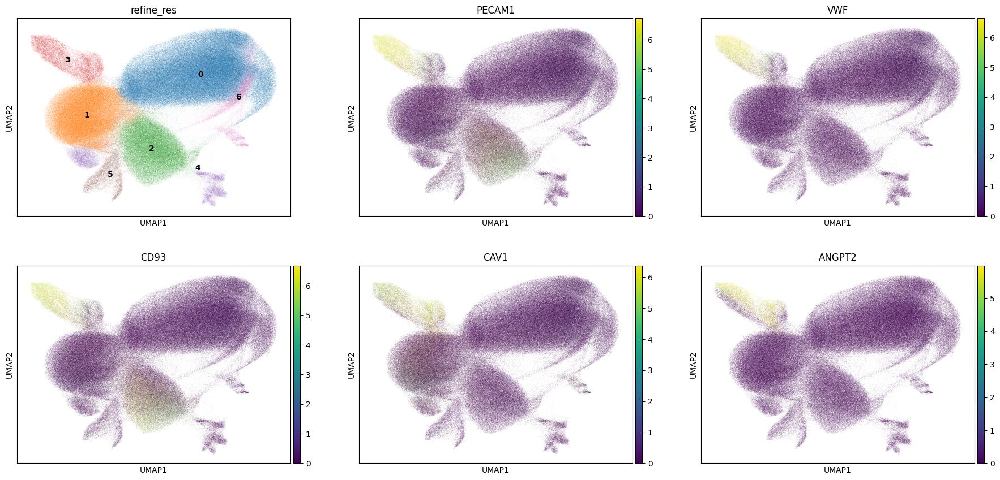

In [87]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*5:int(cluster_id)*5+5], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [58]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 3: 41757
Percentage of cells in cluster 3: 5.5


In [88]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'Endothelial'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'Endothelial'

### 5.5. Cluster 4

In [89]:
cluster_id = '4'

In [90]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
28,4,Mast cell,20
29,4,SCGB3A1 mammary luminal progenitor,8
30,4,CXCL+ fibroblast,6
31,4,IGFBP6+APOD+ fibroblast,5
32,4,CXCL14 mammary basal cell,4
33,4,Monocyte,4
34,4,CCSER1 mammary basal cell,4


In [91]:
top_ranked_genes[cluster_id]

0      CPA3
1    TPSAB1
2       KIT
3       LUM
4     POSTN
Name: 4, dtype: object

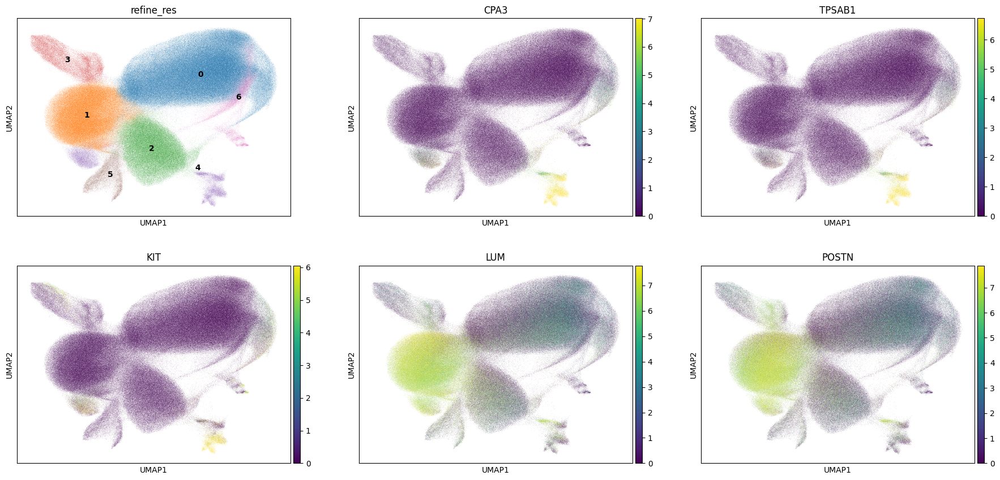

In [92]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*5:int(cluster_id)*5+5], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [93]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 4: 23992
Percentage of cells in cluster 4: 3.2


In [94]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'Mast'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'Mast'

### 5.6. Cluster 5

In [95]:
cluster_id = '5'

In [96]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
35,5,CD4 T cell,43
36,5,GZMB CD8 T cell,18
37,5,Monocyte,6
38,5,SCGB3A1 mammary luminal progenitor,4
39,5,CXCL14 mammary basal cell,4
40,5,Macrophage,4
41,5,GZMK CD8 T cell,2


In [97]:
top_ranked_genes[cluster_id]

0    PTPRC
1     CD3E
2     TRAC
3     CD8A
4     CCL5
Name: 5, dtype: object

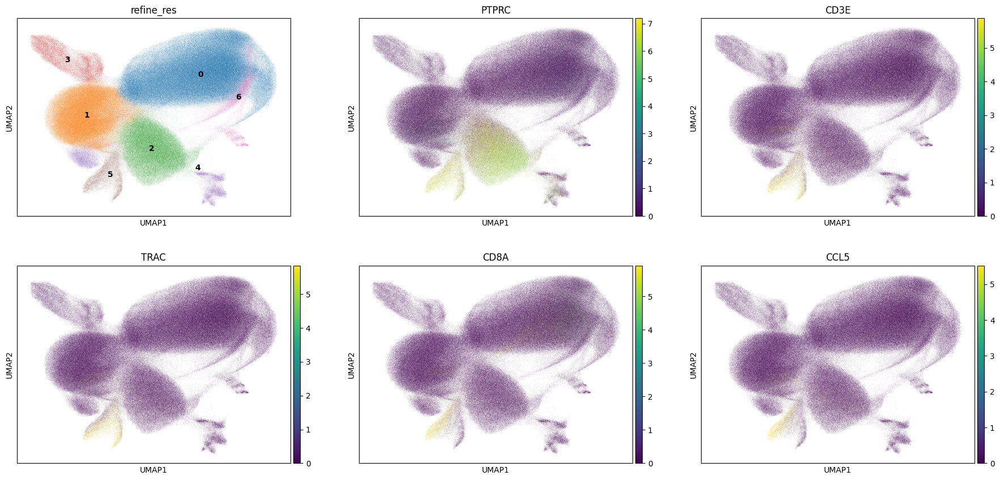

In [98]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*5:int(cluster_id)*5+5], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [99]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 5: 16036
Percentage of cells in cluster 5: 2.1


In [100]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'T'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'T'

### 5.7. Cluster 6

In [101]:
cluster_id = '6'

In [102]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
42,6,CXCL14 mammary basal cell,21
43,6,KRT6B mammary basal cell,17
44,6,Secretoglobin mammary luminal progenitor,17
45,6,SFN mammary luminal progenitor,9
46,6,Cycling mammary luminal progenitor,4
47,6,SCGB3A1 mammary luminal progenitor,3
48,6,Venous EC,3


In [103]:
top_ranked_genes[cluster_id]

0      KRT14
1    TACSTD2
2       KRT7
3        DSP
4      SFRP1
Name: 6, dtype: object

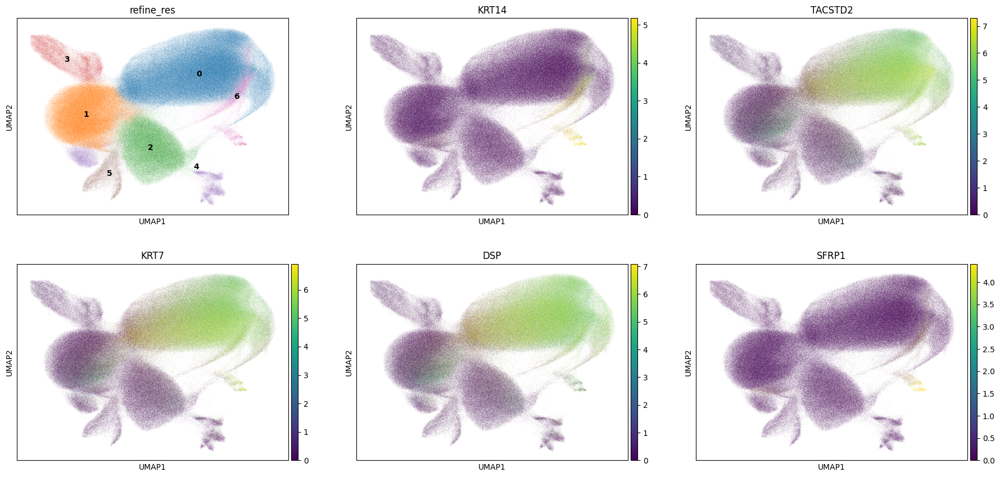

In [104]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*5:int(cluster_id)*5+5], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [105]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 6: 25129
Percentage of cells in cluster 6: 3.3


In [106]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'Epithelial'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'Mammary_basal_cell_(=myoepithelial)'

## 6. Cancer cells

In [109]:
adata.obs['label1'].unique()

array(['Fibroblast', 'Mast', 'Monocyte/Macrophage', 'Epithelial',
       'Endothelial', 'T'], dtype=object)

In [110]:
adata.obs['label2'].unique()

array(['CAF', 'Mast', 'Monocyte/Macrophage', 'Mammary_luminal_cell',
       'Endothelial', 'Mammary_basal_cell_(=myoepithelial)', 'T'],
      dtype=object)

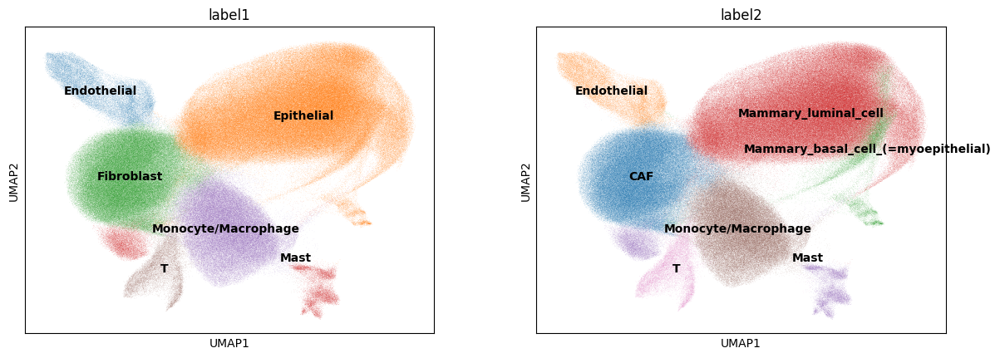

In [111]:
sc.pl.umap(adata, color=['label1', 'label2'], vmax="p99", vmin=0, ncols=4, legend_loc='on data')

In [112]:
# Pathway analysis using KEGG pathways # https://www.genome.jp/brite/br08901

s = KEGG()
data = s.get("hsa05224")
dict_data = s.parse(data)
genes_cancer_ref = [info.split(';')[0] for info in dict_data['GENE'].values()]

print(dict_data['NAME'])

['Breast cancer - Homo sapiens (human)']


In [114]:
genes_cancer = list(set(adata.var_names.tolist()).intersection(genes_cancer_ref))
print(len(genes_cancer))

8


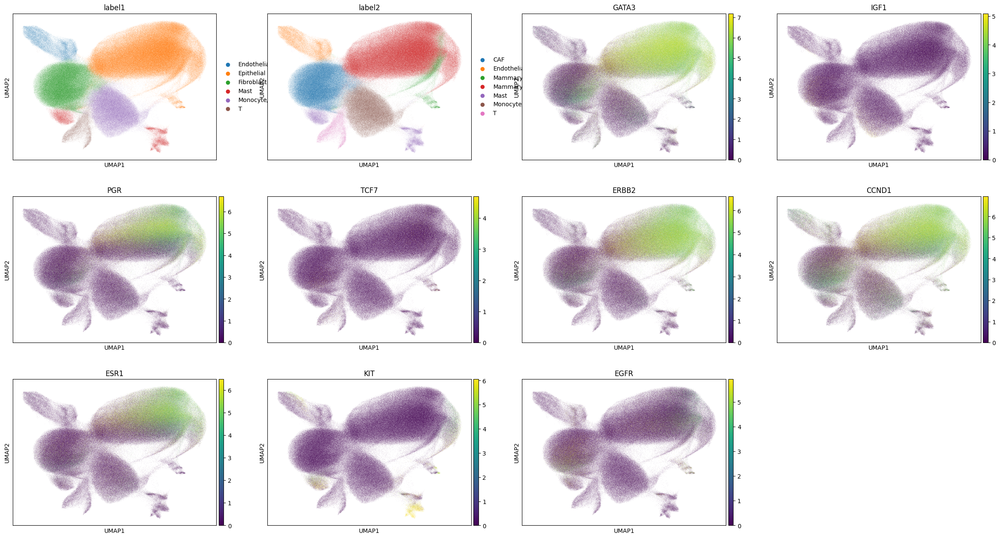

In [117]:
sc.pl.umap(adata, color=['label1', 'label2', 'GATA3'] + genes_cancer, vmax="p99", vmin=0, ncols=4)

In [118]:
adata.obs['label2'].unique()

['CAF', 'Mast', 'Monocyte/Macrophage', 'Mammary_luminal_cell', 'Endothelial', 'Mammary_basal_cell_(=myoepithelial)', 'T']
Categories (7, object): ['CAF', 'Endothelial', 'Mammary_basal_cell_(=myoepithelial)', 'Mammary_luminal_cell', 'Mast', 'Monocyte/Macrophage', 'T']

In [5]:
# Cancer cells
adata.obs['label3'] = 'normal_cell'
adata.obs.loc[adata.obs['label1'].isin(['Epithelial']), 'label3'] = 'cancer_cell'

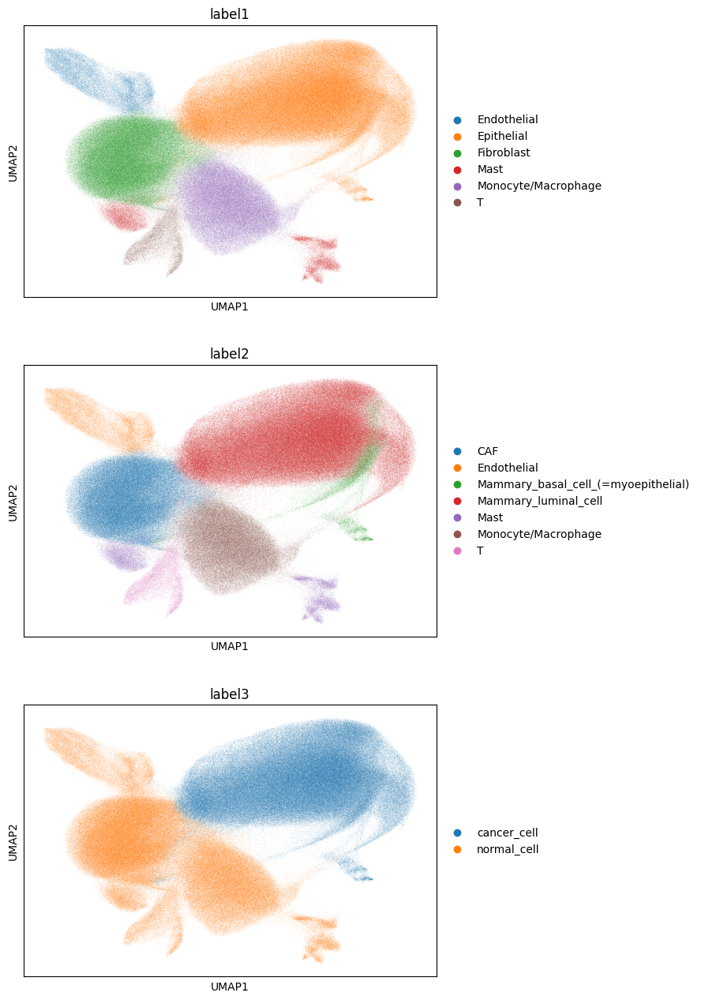

In [6]:
sc.pl.umap(adata, color=['label1', 'label2', 'label3'], ncols=1)

## 7. Save

In [7]:
adata.obs

,region,slide,cell_id,area,ct_tangram,transcript_counts,pca_n10_pcs16_leiden_res0.2,pca_n10_pcs16_leiden_res0.4,pca_n10_pcs16_leiden_res0.6,refine_res,label1,label2,label3
aaaaaaaa-1,nucleus_boundaries,morpho,aaaaaaaa-1,29.508303,Monocyte,37,1,1,2,1,Fibroblast,CAF,normal_cell
aaaaaaab-1,nucleus_boundaries,morpho,aaaaaaab-1,28.244812,CREB+MT1A+ vascular smooth muscle cell,22,1,1,2,1,Fibroblast,CAF,normal_cell
aaaaaaad-1,nucleus_boundaries,morpho,aaaaaaad-1,50.282740,SCGB3A1 mammary luminal progenitor,47,5,6,10,4,Mast,Mast,normal_cell
aaaaaaae-1,nucleus_boundaries,morpho,aaaaaaae-1,56.647940,CCL19/21 pericyte,43,1,1,2,1,Fibroblast,CAF,normal_cell
aaaaaaag-1,nucleus_boundaries,morpho,aaaaaaag-1,91.058119,Venous EC,97,2,2,6,2,Monocyte/Macrophage,Monocyte/Macrophage,normal_cell
...,...,...,...,...,...,...,...,...,...,...,...,...,...
aaankabm-1,nucleus_boundaries,morpho,aaankabm-1,24.492701,Macrophage,34,2,2,6,2,Monocyte/Macrophage,Monocyte/Macrophage,normal_cell
aaankabn-1,nucleus_boundaries,morpho,aaankabn-1,206.252106,SFN mammary luminal progenitor,258,0,0,1,0,Epithelial,Mammary_luminal_cell,cancer_cell
aaankabo-1,nucleus_boundaries,morpho,aaankabo-1,24.613166,CXCL+ fibroblast,40,0,3,0,0,Epithelial,Mammary_luminal_cell,cancer_cell
aaankacd-1,nucleus_boundaries,morpho,aaankacd-1,127.343219,KRT6B mammary basal cell,61,0,0,1,0,Epithelial,Mammary_luminal_cell,cancer_cell


In [8]:
adata.write_h5ad(f"/Volumes/DD_FGS/MICS/data_HE2CellType/CT_DS/adata_refine_tangram/adata_refine_tangram_{slide_id}.h5ad")
# adata = sc.read_h5ad(f"/Volumes/DD_FGS/MICS/data_HE2CellType/CT_DS/adata_refine_tangram/adata_refine_tangram_{slide_id}.h5ad")